# Refine tangram annotations using clustering for bone_marrow_s1

In [1]:
slide_id = "bone_marrow_s1"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_{slide_id}.zarr")
sdata

SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_tangram_annots/sdata_tangram_bone_marrow_s1.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 36523, 13762), (3, 18262, 6881)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     └── 'nucleus_boundaries': GeoDataFrame shape: (84518, 1) (2D shapes)
└── Tables
      └── 'table': AnnData (84518, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), nucleus_boundaries (Shapes)

In [4]:
adata_ini = sdata.table.copy()
adata_ini

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4314/823217089.py:1: DeprecationWarning: Table accessor will be deprecated with SpatialData version 0.1, use sdata.tables instead.
  adata_ini = sdata.table.copy()


AnnData object with n_obs × n_vars = 84518 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram'
    uns: 'sopa_attrs', 'spatialdata_attrs'
    obsm: 'spatial', 'tangram_pred'

In [5]:
adata_ini.obs

,region,slide,cell_id,area,ct_tangram
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,23.910722,Naive CD8 T cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,22.804023,Early SOX4+ erythroblast
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,10.747582,cDC2 (cycling)
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,13.140622,ILC
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,28.584145,CD14+MHCIIhigh monocyte
...,...,...,...,...,...
aaabekcb-1,nucleus_boundaries,morpho,aaabekcb-1,15.150355,pre-pDC (lymphoid origin)
aaabekcc-1,nucleus_boundaries,morpho,aaabekcc-1,3.544945,cDC1
aaabekcd-1,nucleus_boundaries,morpho,aaabekcd-1,29.959769,Naive CD8 T cell
aaabekce-1,nucleus_boundaries,morpho,aaabekce-1,16.595272,CD14+MHCIIhigh monocyte


In [6]:
adata_ini.var

""
ABCC11
ACAN
ACE2
ACKR1
ACTA2
...
VPREB3
VSIG4
VWA5A
VWF


## 2. Preprocessing

In [7]:
# Add transcripts counts
adata_ini.obs["transcript_counts"] = adata_ini.X.sum(axis=1)
adata_ini.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,23.910722,Naive CD8 T cell,14
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,22.804023,Early SOX4+ erythroblast,19
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,10.747582,cDC2 (cycling),4
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,13.140622,ILC,5
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,28.584145,CD14+MHCIIhigh monocyte,22
...,...,...,...,...,...,...
aaabekcb-1,nucleus_boundaries,morpho,aaabekcb-1,15.150355,pre-pDC (lymphoid origin),10
aaabekcc-1,nucleus_boundaries,morpho,aaabekcc-1,3.544945,cDC1,2
aaabekcd-1,nucleus_boundaries,morpho,aaabekcd-1,29.959769,Naive CD8 T cell,34
aaabekce-1,nucleus_boundaries,morpho,aaabekce-1,16.595272,CD14+MHCIIhigh monocyte,21


<Axes: >

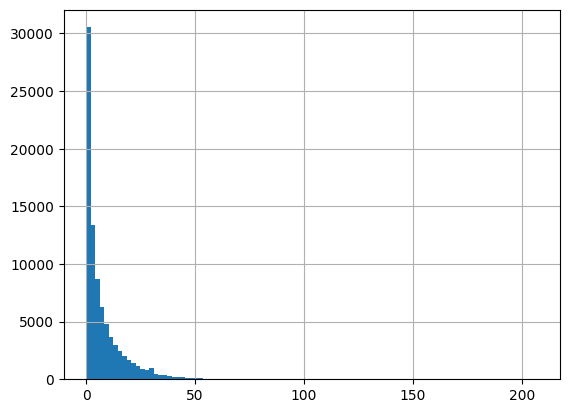

In [8]:
adata_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

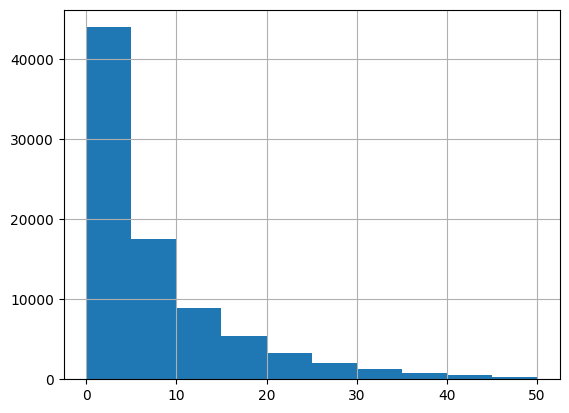

In [9]:
# in range 0-50
adata_ini.obs['transcript_counts'].hist(range=(0,50))

In [10]:
print(f"Number of cells with less than 20 transcripts: {(adata_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_ini.obs['transcript_counts']<20).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_ini.obs['transcript_counts']<15).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_ini.obs['transcript_counts']<10).sum())/len(adata_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_ini.obs)}")

Number of cells with less than 20 transcripts: 75690
Percentage of cells with less than 20 transcripts: 89.55%
-----
Number of cells with less than 15 transcripts: 70326
Percentage of cells with less than 15 transcripts: 83.21%
-----
Number of cells with less than 10 transcripts: 61455
Percentage of cells with less than 10 transcripts: 72.71%
-----
Number total of cells: 84518


In [11]:
adata =  adata_ini[adata_ini.obs['transcript_counts']>10].copy()
print(len(adata.obs))

20792


In [12]:
# Save the raw data
adata.layers['count'] = adata.X.copy()

In [13]:
# Normalize
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.layers['log_norm'] = adata.X.copy()

In [14]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value=10)

## 3. Principal component analysis

In [15]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


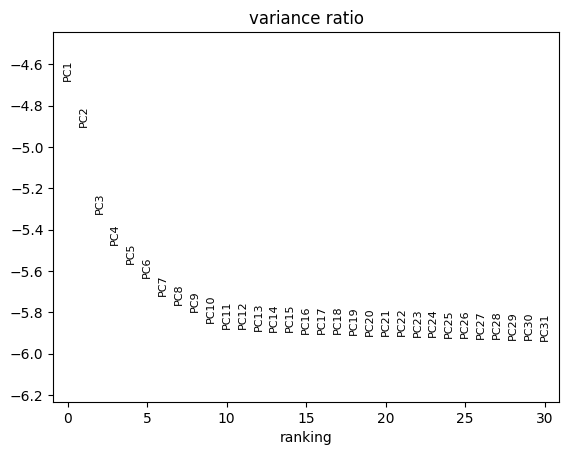

In [16]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata, log=True)

In [17]:
adata

AnnData object with n_obs × n_vars = 20792 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts'
    var: 'mean', 'std'
    uns: 'sopa_attrs', 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'tangram_pred', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [18]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [19]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata, n_neighbors=10, n_pcs=11, use_rep="X_pca", key_added='pca_n10_pcs11')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata, neighbors_key='pca_n10_pcs11')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs11_leiden_res0.2', neighbors_key='pca_n10_pcs11')
sc.tl.leiden(adata, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs11_leiden_res0.4', neighbors_key='pca_n10_pcs11')
sc.tl.leiden(adata, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs11_leiden_res0.6', neighbors_key='pca_n10_pcs11')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4314/3196629807.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs11_leiden_res0.2', neighbors_key='pca_n10_pcs11')


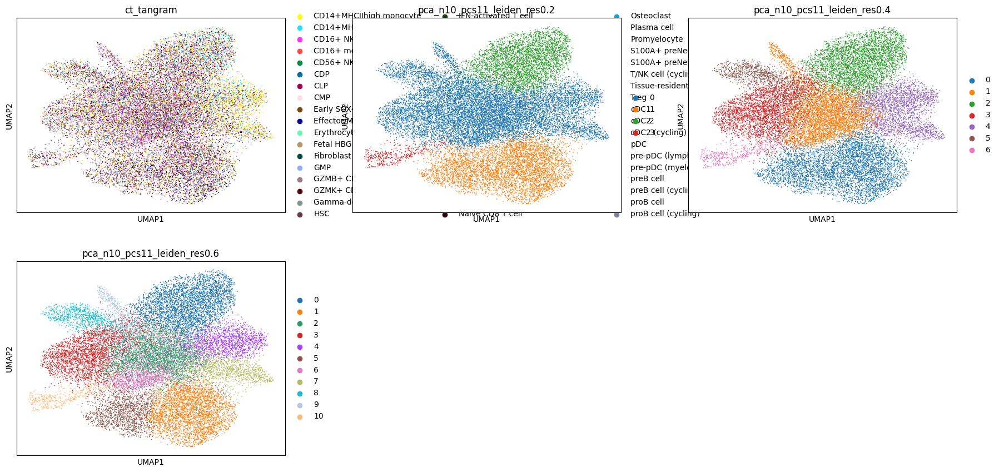

In [20]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs11',
           color=['ct_tangram', 'pca_n10_pcs11_leiden_res0.2', 'pca_n10_pcs11_leiden_res0.4', 'pca_n10_pcs11_leiden_res0.6'],
           ncols=3)

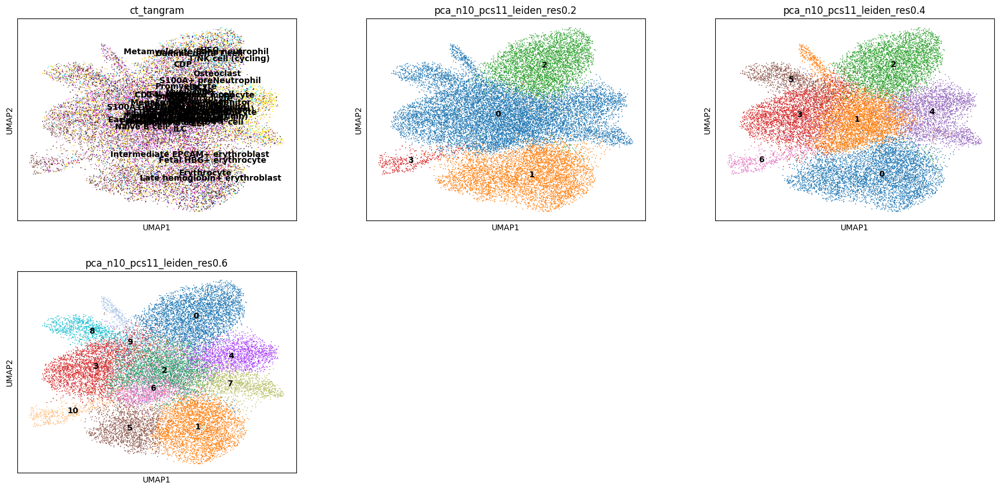

In [21]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs11',
           color=['ct_tangram', 'pca_n10_pcs11_leiden_res0.2', 'pca_n10_pcs11_leiden_res0.4', 'pca_n10_pcs11_leiden_res0.6'],
           ncols=3, legend_loc='on data')

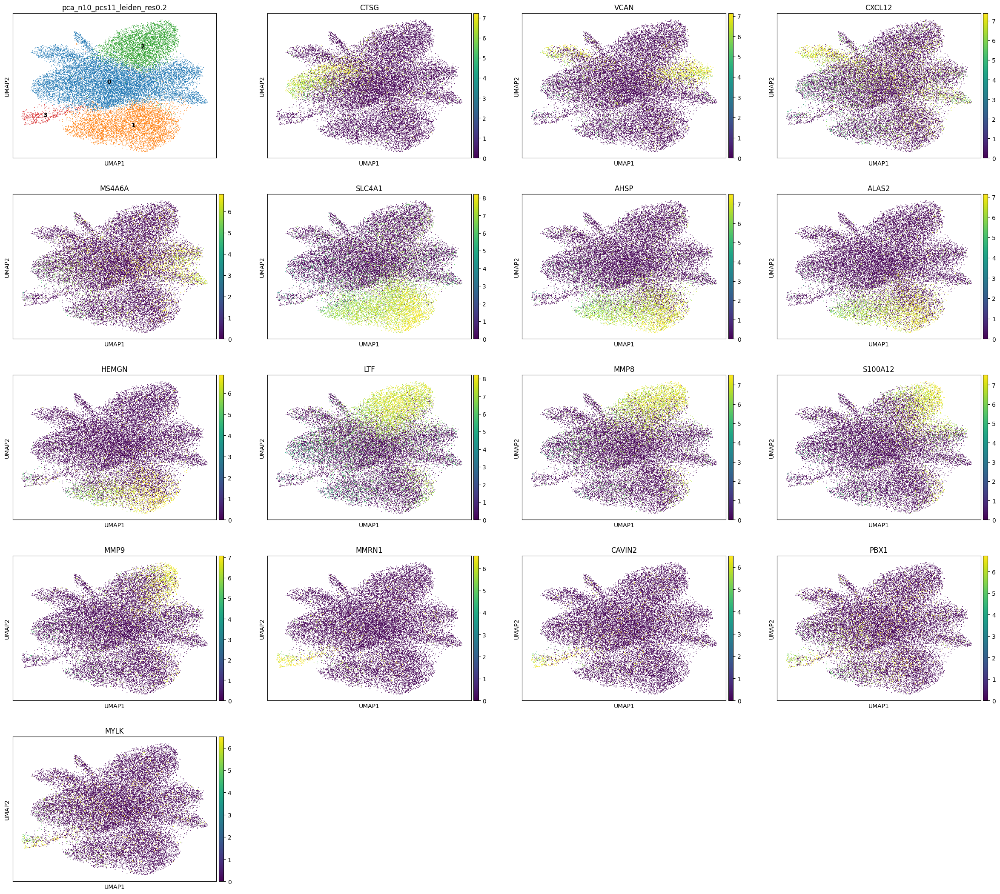

In [22]:
clustering_label = 'pca_n10_pcs11_leiden_res0.2'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

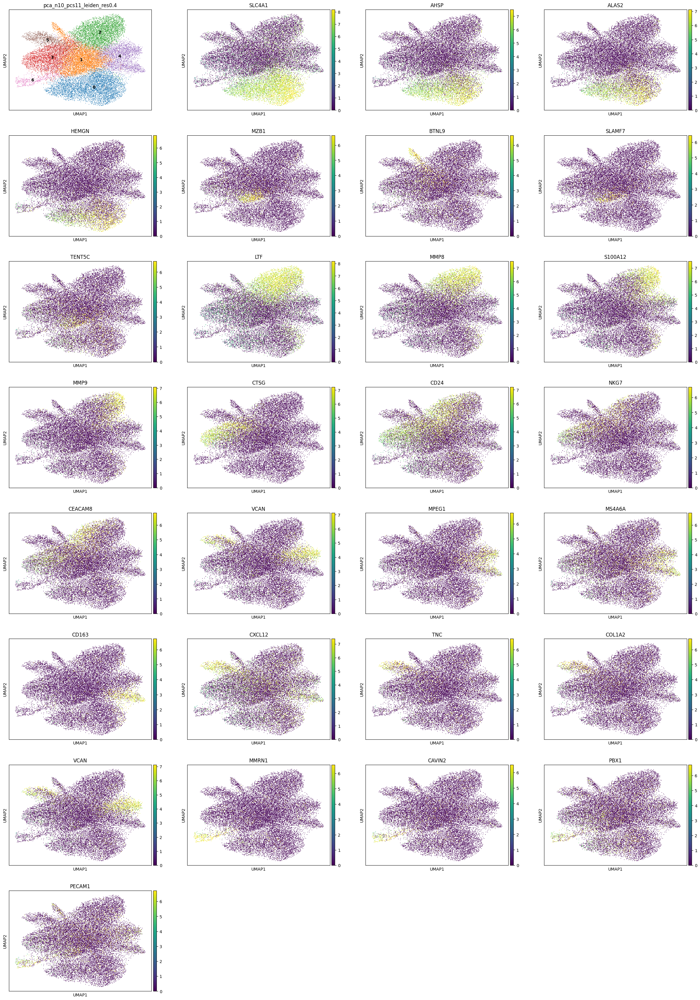

In [23]:
clustering_label = 'pca_n10_pcs11_leiden_res0.4'

# Wilcoxon rank-sum (Mann-Whitney-U) test
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)

# The 4 top ranked genes per cluster
df = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:4, :]
list_genes = pd.concat([df[col] for col in df], ignore_index=True).tolist()
sc.pl.umap(adata, color=[clustering_label]+list_genes, vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [24]:
# Number of clusters
adata.obs['pca_n10_pcs11_leiden_res0.6'].unique()

['1', '5', '6', '2', '4', ..., '9', '3', '0', '8', '10']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [25]:
# Refine resolution
adata.obs['refine_res'] = 'att'

adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['0']), 'refine_res'] = '0'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['1']), 'refine_res'] = '1'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['2']), 'refine_res'] = '2'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['3']), 'refine_res'] = '3'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['4']), 'refine_res'] = '4'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['5']), 'refine_res'] = '5'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['6']), 'refine_res'] = '6'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['7']), 'refine_res'] = '7'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['8']), 'refine_res'] = '8'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['9']), 'refine_res'] = '9'
adata.obs.loc[adata.obs['pca_n10_pcs11_leiden_res0.6'].isin(['10']), 'refine_res'] = '10'

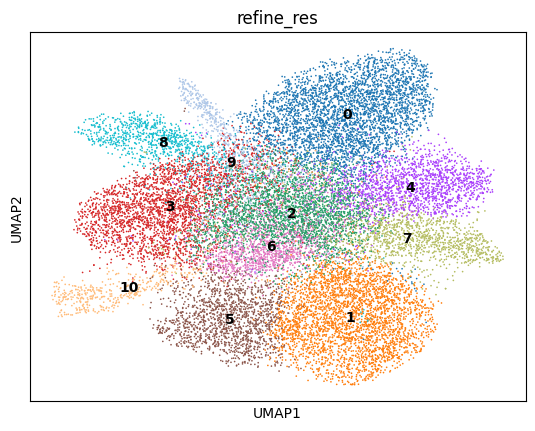

In [26]:
# Plot the clusters
sc.pl.umap(adata, neighbors_key='pca_n10_pcs11', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [27]:
clustering_label = 'refine_res'

In [28]:
def get_top_tangram_labels_for_clustering(adata, clustering_key, top_n=3):

    grouped = adata.obs.groupby(clustering_key)
    results = []
    
    for cluster, group in grouped:
        
        label_counts = Counter(group['ct_tangram'])
        total_cells = len(group)
        label_percentages = [(label, round(count / total_cells * 100)) for label, count in label_counts.items()]
        top_labels = sorted(label_percentages, key=lambda x: x[1], reverse=True)[:top_n]
        
        for label, percentage in top_labels:
            results.append({
                'Cluster': cluster,
                'Label': label,
                'Percentage': percentage
            })
    
    cluster_df = pd.DataFrame(results)
    
    return cluster_df

top_tangram = get_top_tangram_labels_for_clustering(adata, clustering_label, top_n=7)

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_4314/3112203278.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  grouped = adata.obs.groupby(clustering_key)


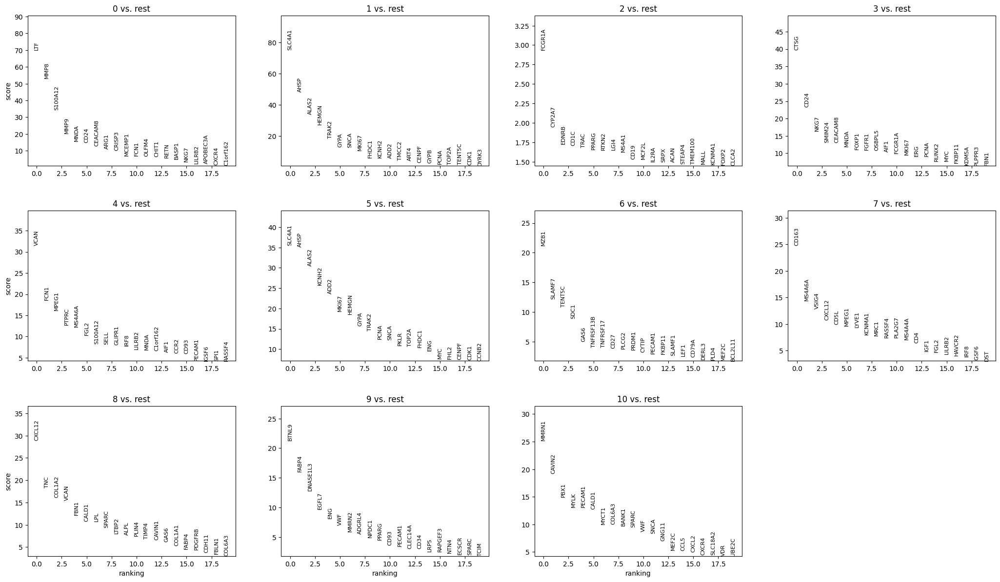

In [29]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [30]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata.uns["rank_genes_"+clustering_label]["names"]).iloc[:5, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [31]:
adata.obs['label1'] = 'att'
adata.obs['label2'] = 'att'
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

### 5.1. Cluster 0

In [32]:
cluster_id = '0'

In [33]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
0,0,S100A+ preNeutrophil (cycling),13
1,0,CD14+MHCIIlow monocyte,12
2,0,Naive B cell,9
3,0,Naive CD8 T cell,9
4,0,preB cell,9
5,0,CD14+MHCIIhigh monocyte,8
6,0,CD16+ NK,5


In [34]:
top_ranked_genes[cluster_id]

0        LTF
1       MMP8
2    S100A12
3       MMP9
4       MNDA
Name: 0, dtype: object

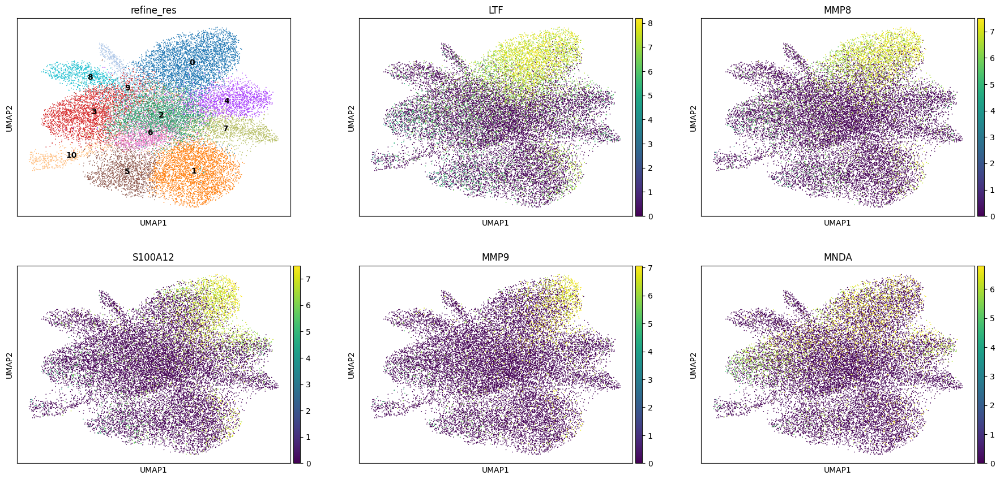

In [35]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [36]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 3700
Percentage of cells in cluster 0: 17.8


In [37]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Neutrophil'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Neutrophil'

### 5.2. Cluster 1

In [38]:
cluster_id = '1'

In [39]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
7,1,Naive CD8 T cell,12
8,1,Naive B cell,11
9,1,S100A+ preNeutrophil (cycling),8
10,1,preB cell,7
11,1,Effector/Memory CD4 T cell,6
12,1,Early SOX4+ erythroblast,5
13,1,CD16+ NK,5


In [40]:
top_ranked_genes[cluster_id]

0    SLC4A1
1      AHSP
2     ALAS2
3     HEMGN
4     TRAK2
Name: 1, dtype: object

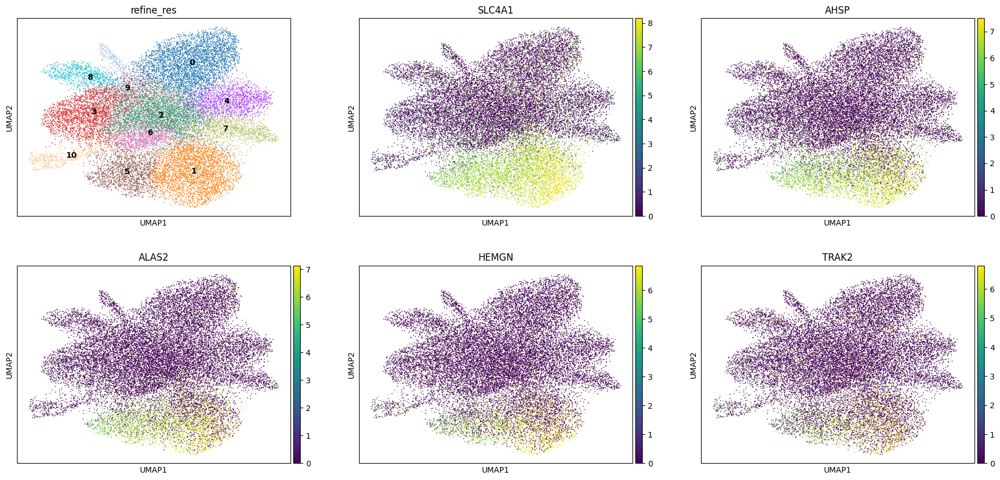

In [41]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [42]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 3197
Percentage of cells in cluster 1: 15.4


In [43]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Erythroid_cell'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Erythroid_cell'

### 5.3. Cluster 2

In [44]:
cluster_id = '2'

In [45]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
14,2,Naive B cell,18
15,2,preB cell,12
16,2,Naive CD8 T cell,8
17,2,CD16+ NK,7
18,2,S100A+ preNeutrophil (cycling),7
19,2,Memory B cell,6
20,2,CD14+MHCIIhigh monocyte,6


In [46]:
top_ranked_genes[cluster_id]

0    FCGR1A
1    CYP2A7
2     EDNRB
3      CD1C
4      TRAC
Name: 2, dtype: object

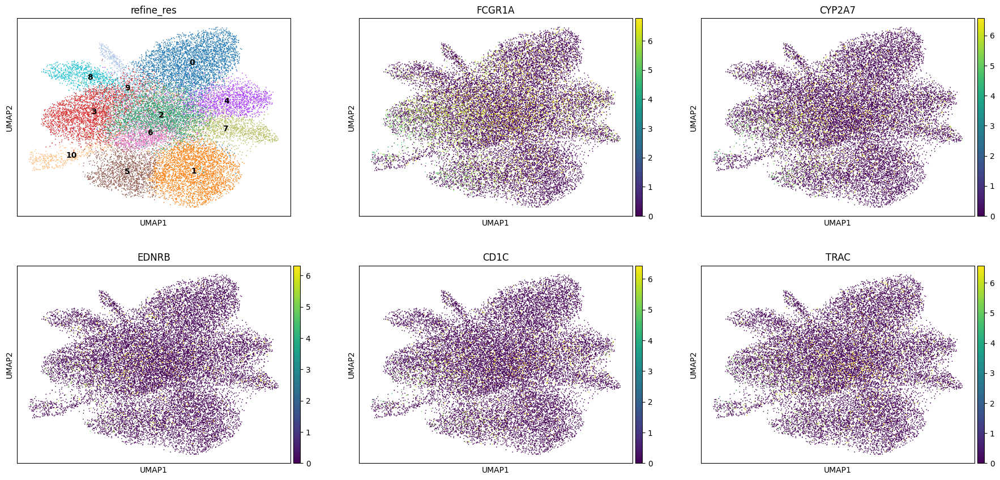

In [47]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [49]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 2864
Percentage of cells in cluster 2: 13.8


In [50]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Unknown'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Unknown'

### 5.4. Cluster 3

In [51]:
cluster_id = '3'

In [52]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
21,3,Naive B cell,27
22,3,preB cell,19
23,3,Naive CD8 T cell,11
24,3,S100A+ preNeutrophil (cycling),10
25,3,CD14+MHCIIhigh monocyte,6
26,3,CD14+MHCIIlow monocyte,5
27,3,CD16+ NK,5


In [53]:
top_ranked_genes[cluster_id]

0       CTSG
1       CD24
2       NKG7
3     SMIM24
4    CEACAM8
Name: 3, dtype: object

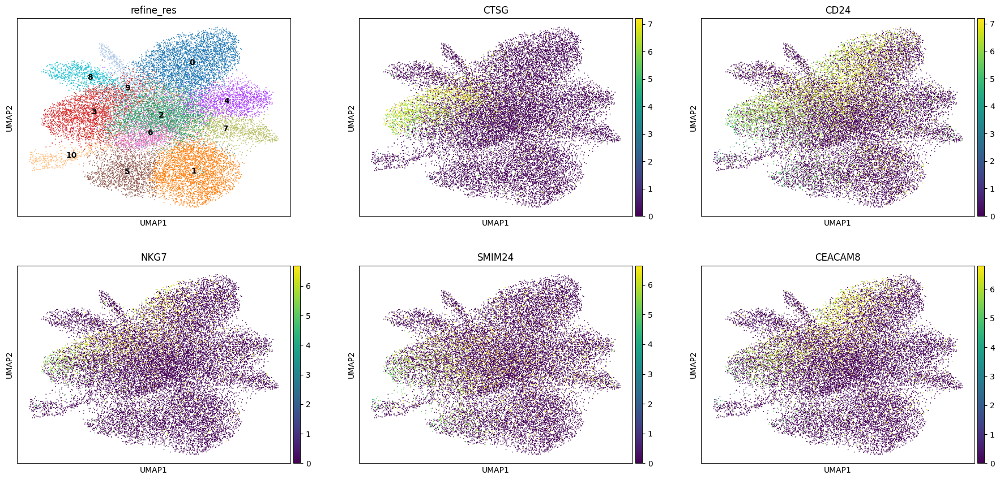

In [54]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [55]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 2756
Percentage of cells in cluster 3: 13.3


In [56]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Neutrophil'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Neutrophil'

### 5.5. Cluster 4

In [57]:
cluster_id = '4'

In [58]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
28,4,CD14+MHCIIhigh monocyte,20
29,4,S100A+ preNeutrophil (cycling),19
30,4,Naive B cell,14
31,4,CD14+MHCIIlow monocyte,12
32,4,preB cell,10
33,4,Naive CD8 T cell,7
34,4,CD16+ NK,4


In [59]:
top_ranked_genes[cluster_id]

0      VCAN
1      FCN1
2     MPEG1
3     PTPRC
4    MS4A6A
Name: 4, dtype: object

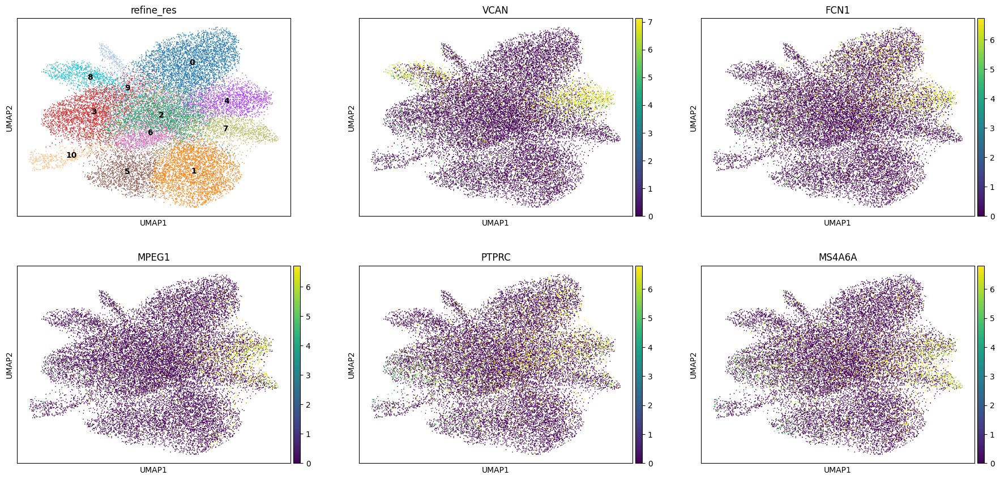

In [60]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [61]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 1736
Percentage of cells in cluster 4: 8.3


In [62]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.6. Cluster 5

In [63]:
cluster_id = '5'

In [64]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
35,5,Naive B cell,32
36,5,preB cell,17
37,5,Naive CD8 T cell,13
38,5,S100A+ preNeutrophil (cycling),10
39,5,CD14+MHCIIhigh monocyte,7
40,5,CD16+ NK,5
41,5,CD14+MHCIIlow monocyte,4


In [65]:
top_ranked_genes[cluster_id]

0    SLC4A1
1      AHSP
2     ALAS2
3     KCNH2
4      ADD2
Name: 5, dtype: object

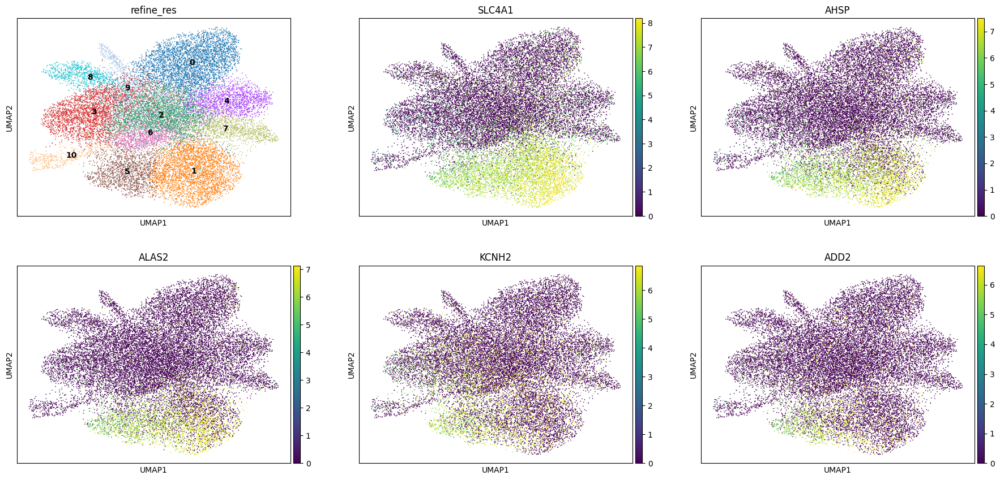

In [66]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [67]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 1518
Percentage of cells in cluster 5: 7.3


In [68]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Erythroid_cell'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Erythroid_cell'

### 5.7. Cluster 6

In [69]:
cluster_id = '6'

In [70]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
42,6,preB cell,22
43,6,Naive B cell,17
44,6,Memory B cell,8
45,6,Naive CD8 T cell,7
46,6,S100A+ preNeutrophil (cycling),7
47,6,GZMB+ CD8 T cell,6
48,6,CD16+ NK,6


In [71]:
top_ranked_genes[cluster_id]

0      MZB1
1    SLAMF7
2    TENT5C
3      SDC1
4      GAS6
Name: 6, dtype: object

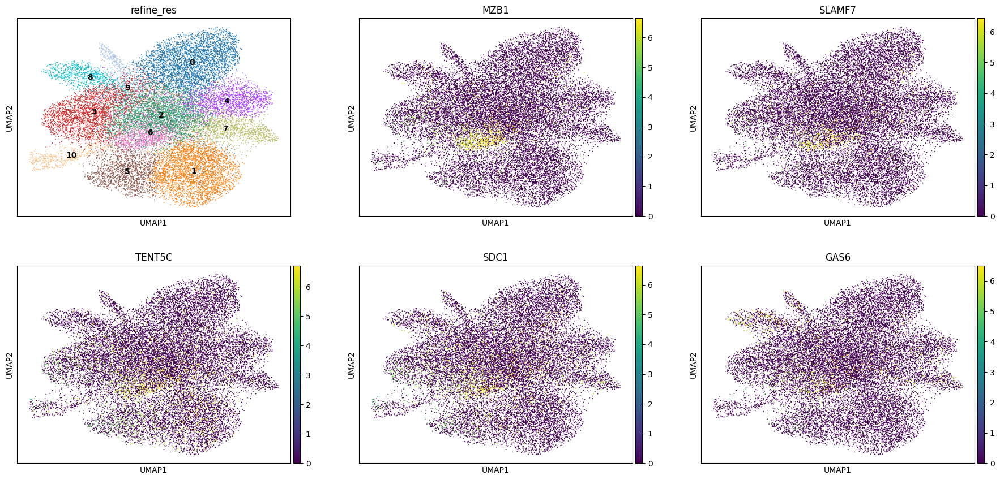

In [72]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [73]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 1378
Percentage of cells in cluster 6: 6.6


In [74]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Plasma'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Plasma'

### 5.8. Cluster 7

In [75]:
cluster_id = '7'

In [76]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
49,7,CD14+MHCIIhigh monocyte,18
50,7,Naive B cell,16
51,7,preB cell,13
52,7,S100A+ preNeutrophil (cycling),10
53,7,CD14+MHCIIlow monocyte,6
54,7,Naive CD8 T cell,6
55,7,CD16+ NK,5


In [77]:
top_ranked_genes[cluster_id]

0     CD163
1    MS4A6A
2     VSIG4
3    CXCL12
4      CD5L
Name: 7, dtype: object

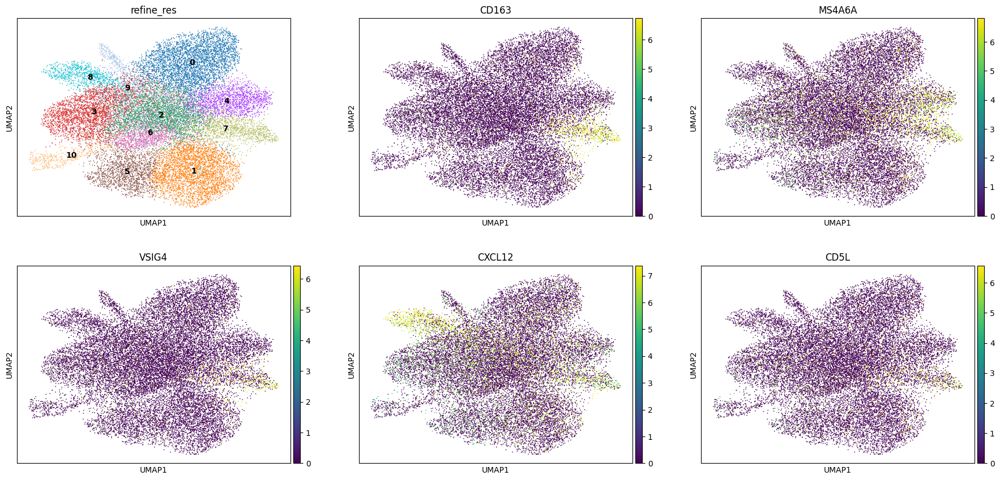

In [78]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [79]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 1305
Percentage of cells in cluster 7: 6.3


In [80]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.9. Cluster 8

In [81]:
cluster_id = '8'

In [82]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
56,8,Naive B cell,14
57,8,preB cell,11
58,8,S100A+ preNeutrophil (cycling),11
59,8,Naive CD8 T cell,9
60,8,Early SOX4+ erythroblast,7
61,8,CD14+MHCIIhigh monocyte,6
62,8,CD14+MHCIIlow monocyte,5


In [83]:
top_ranked_genes[cluster_id]

0    CXCL12
1       TNC
2    COL1A2
3      VCAN
4      FBN1
Name: 8, dtype: object

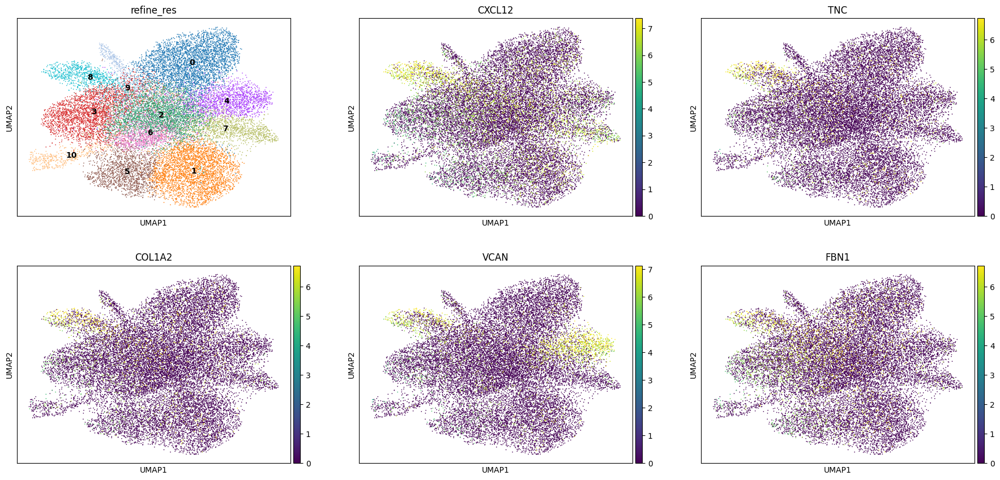

In [84]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [85]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 983
Percentage of cells in cluster 8: 4.7


In [86]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.10. Cluster 9

In [87]:
cluster_id = '9'

In [88]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
63,9,preB cell,20
64,9,Naive B cell,13
65,9,Naive CD8 T cell,9
66,9,S100A+ preNeutrophil (cycling),8
67,9,CD16+ NK,6
68,9,Early SOX4+ erythroblast,5
69,9,Effector/Memory CD4 T cell,5


In [89]:
top_ranked_genes[cluster_id]

0       BTNL9
1       FABP4
2    DNASE1L3
3       EGFL7
4         ENG
Name: 9, dtype: object

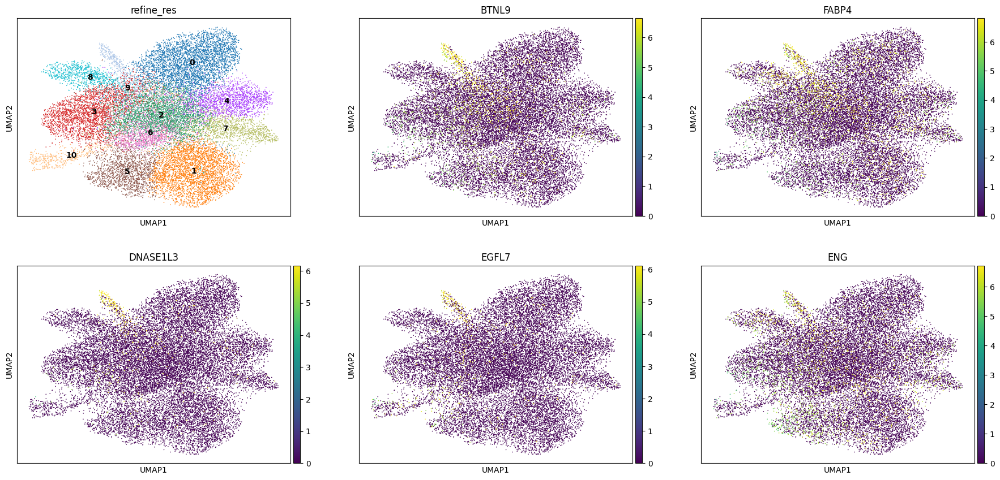

In [90]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [91]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 845
Percentage of cells in cluster 9: 4.1


In [92]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Mesenchymal_stromal_cell'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'MSC'

### 5.11. Cluster 10

In [93]:
cluster_id = '10'

In [94]:
top_tangram[top_tangram.Cluster==cluster_id]

,Cluster,Label,Percentage
70,10,Naive B cell,32
71,10,preB cell,16
72,10,S100A+ preNeutrophil (cycling),7
73,10,Naive CD8 T cell,7
74,10,Early SOX4+ erythroblast,6
75,10,CD16+ NK,5
76,10,Memory B cell,4


In [95]:
top_ranked_genes[cluster_id]

0     MMRN1
1    CAVIN2
2      PBX1
3      MYLK
4    PECAM1
Name: 10, dtype: object

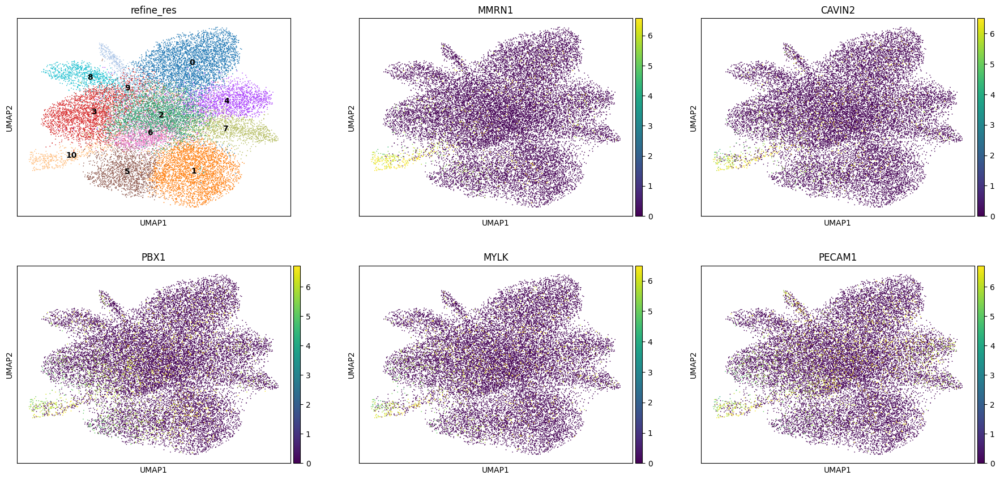

In [96]:
sc.pl.umap(adata, color=[clustering_label]+list_genes[int(cluster_id)*5:int(cluster_id)*5+5], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [97]:
print(f"Number of cells in cluster {cluster_id}: {len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata.obs[clustering_label][adata.obs[clustering_label]==cluster_id]) / len(adata.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 510
Percentage of cells in cluster 10: 2.5


In [98]:
adata.obs['label1'] = adata.obs['label1'].astype('str')
adata.obs['label2'] = adata.obs['label2'].astype('str')

adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata.obs.loc[adata.obs['refine_res'] == cluster_id, 'label2'] = 'Endothelial'

## 6. Cancer cells

In [101]:
adata.obs['label1'].unique()

array(['Erythroid_cell', 'Plasma', 'Unknown', 'Monocyte/Macrophage',
       'Mesenchymal_stromal_cell', 'Neutrophil', 'Fibroblast',
       'Endothelial'], dtype=object)

In [102]:
adata.obs['label2'].unique()

array(['Erythroid_cell', 'Plasma', 'Unknown', 'Monocyte/Macrophage',
       'MSC', 'Neutrophil', 'Fibroblast', 'Endothelial'], dtype=object)

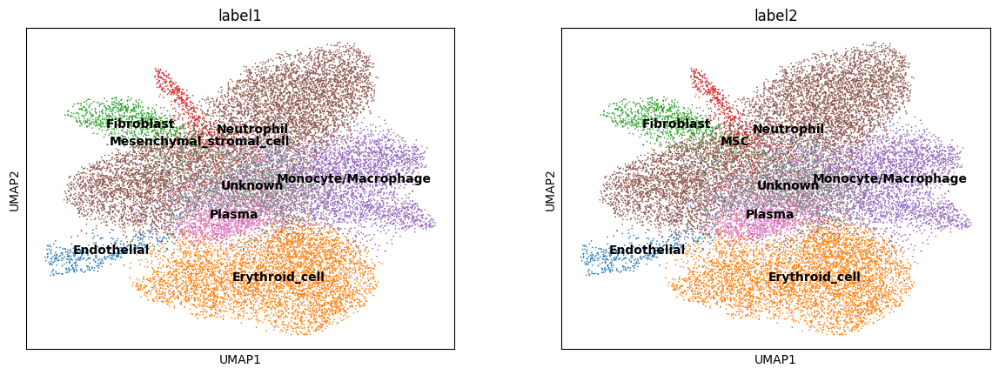

In [103]:
sc.pl.umap(adata, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [104]:
# Cancer cells
adata.obs['label3'] = 'normal_cell'

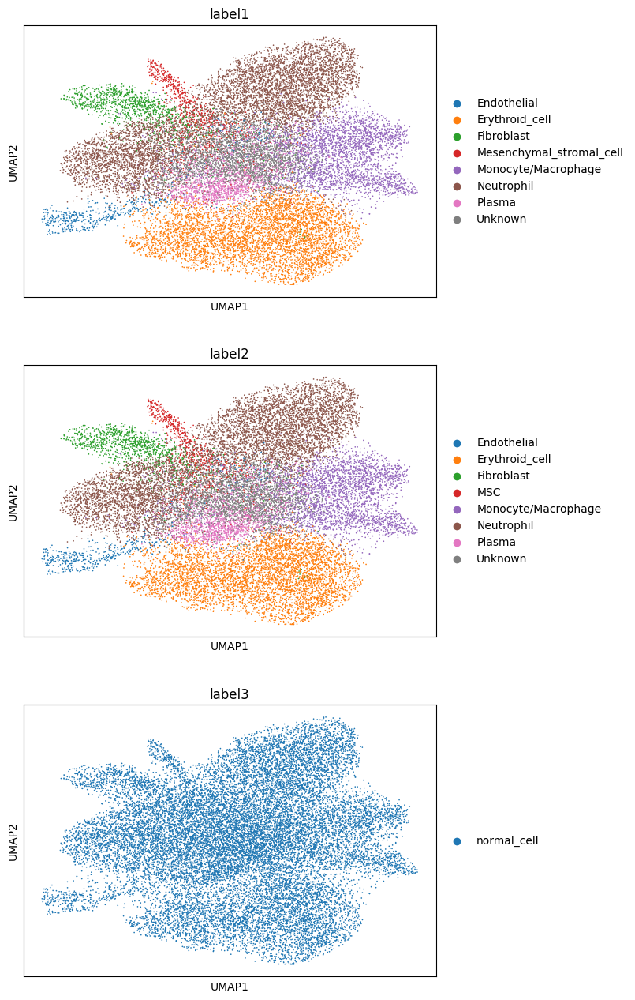

In [105]:
sc.pl.umap(adata, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [106]:
adata.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs11_leiden_res0.2,pca_n10_pcs11_leiden_res0.4,pca_n10_pcs11_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,23.910722,Naive CD8 T cell,14,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaab-1,nucleus_boundaries,morpho,aaaaaaab-1,22.804023,Early SOX4+ erythroblast,19,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,28.584145,CD14+MHCIIhigh monocyte,22,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,25.129637,S100A+ preNeutrophil (cycling),24,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaaaaaag-1,nucleus_boundaries,morpho,aaaaaaag-1,24.113518,Naive CD8 T cell,37,1,0,5,5,Erythroid_cell,Erythroid_cell,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaabekbo-1,nucleus_boundaries,morpho,aaabekbo-1,35.966385,S100A+ preNeutrophil (cycling),60,0,3,3,3,Neutrophil,Neutrophil,normal_cell
aaabekbp-1,nucleus_boundaries,morpho,aaabekbp-1,16.189590,CMP,13,1,0,1,1,Erythroid_cell,Erythroid_cell,normal_cell
aaabekcd-1,nucleus_boundaries,morpho,aaabekcd-1,29.959769,Naive CD8 T cell,34,2,3,3,3,Neutrophil,Neutrophil,normal_cell
aaabekce-1,nucleus_boundaries,morpho,aaabekce-1,16.595272,CD14+MHCIIhigh monocyte,21,0,1,2,2,Unknown,Unknown,normal_cell


In [107]:
adata.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
# adata = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")